## Environmental Source Apportionment Toolkit (ESAT) Simulator


In [1]:
# When running from Google Colab or another Jupyter notebook cloud environment, the ESAT python package may need to be installed.
# If the python package file is available locally, run a pip install for the specific wheel for your current OS/Arch

#installation of wheel for the first time
#!pip install "path to wheel file"

#installation of an updated wheel over an already existing wheel
#!pip install --force-reinstall "path to wheel file"

#### Code Imports

In [2]:
from esat.data.datahandler import DataHandler
from esat.model.batch_sa import BatchSA
from esat.data.analysis import ModelAnalysis, BatchAnalysis
from esat_eval.simulator import Simulator
from esat.estimator import FactorEstimator

#### Synthetic Dataset

Generate synthetic input (V) and uncertainty (U) datasets for model analysis. V and U are generated in the following sequence:

1.	Feature profiles are defined and/or randomly generated (H); if the latter, for each feature, a random number of factors between 1 and K are chosen as sources for that feature. For each contributing factor, a random contribution (uniform value between 0 and 1) is assigned. If one or more predefined factor profiles (a row of H) are provided by the user, they are assigned to H in order of occurrence and overwrite the corresponding randomly generated row of H.
2.	Sample concentrations are defined and/or randomly generated (W); if the latter, each cell of W is set to a random uniform number between 0 and contribution_max
3.	V1 is calculated as the product W x H
4.	A noise matrix (N) is created by selecting values from a normal distribution with a randomly selected mean noise (uniform distribution between noise_mean_min and noise_mean_max) for each feature, and standard deviation = noise_scale. The randomly selected mean noise for a feature has a 50% chance to be multiplied by -1 to allow for the reduction of values in V1. Then the Hadamard product (element-wise matrix multiplication) of V1 and N is used to calculate V: V1 + V1◦N -> V
5.  Outliers are added to V if outliers=True. A number of elements in V (a proportion = outlier_p) are randomly selected and each one has a 50% chance to become V*outlier_mag, and a 50% chance to become V/outlier_mag

6.	An uncertainty matrix (U1) is created by selecting values from a normal distribution with a randomly selected mean uncertainty (uniform distribution between uncertainty_mean_min and uncertainty_mean_max) for each feature, and standard deviation = uncertainty_scale. Then the Hadamard product of V and U1 is used to calculate U: V◦U1 -> U

In [3]:
# Synethic dataset parameters
seed = 85
syn_factors = 4              # Number of factors in the synthetic dataset
syn_features = 40             # Number of features in the synthetic dataset
syn_samples = 850            # Number of samples in the synthetic dataset
outliers = True               # Add outliers to the dataset
outlier_p = 0.05               # Proportion of outliers
outlier_mag = 1.5             # Magnitude of outliers; a multipier of the data value
contribution_max = 20         # Each cell of W (dimension of samples x factors) is a random unform number between 0 and contribution_max
noise_mean_min = 0.1          # Min value for the mean noise (as a proportion) applied to a specific feature (column of V)
noise_mean_max = 0.2        # Max value for the mean noise (as a proportion) applied to a specific feature (column of V)
noise_scale = 0.02            # Standard deviation of the randomly assigned mean noise for a specific feature; should be 1/3 or less of the minimum noise value to avoid negative noise
uncertainty_mean_min = 0.1   # Min value for the mean uncertainty (as a proportion) applied to a specific feature (column of V)
uncertainty_mean_max = 0.4    # Max value for the mean uncertainty (as a proportion) applied to a specific feature (column of V)
uncertainty_scale = 0.01      # Standard deviation of the randomly assigned mean uncertainty for a specific feature; should be 1/3 or less of the minimum uncertainty value to avoid negative uncertainty

In [4]:
# Initialize the simulator with the above parameters
simulator = Simulator(seed=seed,
                      factors_n=syn_factors,
                      features_n=syn_features,
                      samples_n=syn_samples,
                      outliers=outliers,
                      outlier_p=outlier_p,
                      outlier_mag=outlier_mag,
                      contribution_max=contribution_max,
                      noise_mean_min=noise_mean_min,
                      noise_mean_max=noise_mean_max,
                      noise_scale=noise_scale,
                      uncertainty_mean_min=uncertainty_mean_min,
                      uncertainty_mean_max=uncertainty_mean_max,
                      uncertainty_scale=uncertainty_scale
                     )

23-Aug-24 09:13:15 - Synthetic profiles generated


In [5]:
# Example command for passing in a custom factor profile matrix instead of a randomly generated profile
# my_profile = np.ones(shape=(syn_factors, syn_features))
# simulator.generate_profiles(profiles=my_profile)

In [6]:
# Example of how to customize the factor contributions. Curve_type options: 'uniform', 'decreasing', 'increasing', 'logistic', 'periodic' ; uniform by default
# simulator.update_contribution(factor_i=0, curve_type="logistic", scale=0.1, frequency=0.5)
# simulator.update_contribution(factor_i=1, curve_type="periodic", minimum=0.0, maximum=1.0, frequency=0.5, scale=0.1)
# simulator.update_contribution(factor_i=2, curve_type="increasing", minimum=0.0, maximum=1.0, scale=0.1)
# simulator.update_contribution(factor_i=3, curve_type="decreasing", minimum=0.0, maximum=1.0, scale=0.1)
simulator.plot_synthetic_contributions()

#### Load Data
Assign the processed data and uncertainty datasets to the variables V and U. These steps will be simplified/streamlined in a future version of the code.

In [7]:
syn_input_df, syn_uncertainty_df = simulator.get_data()

23-Aug-24 09:13:16 - Synthetic data generated
23-Aug-24 09:13:16 - Synthetic uncertainty data generated
23-Aug-24 09:13:16 - Synthetic dataframes completed
23-Aug-24 09:13:16 - Synthetic source apportionment instance created.


In [8]:
data_handler = DataHandler.load_dataframe(input_df=syn_input_df, uncertainty_df=syn_uncertainty_df)
V, U = data_handler.get_data()

#### Input/Uncertainty Data Metrics and Visualizations

In [9]:
# Show the input data metrics, including signal to noise ratio of the data and variability of feature concentrations
data_handler.metrics

,Category,S/N,Min,25th,50th,75th,Max
Feature 1,strong,3.593694,0.013236,1.609972,3.166375,4.888617,10.560676
Feature 2,strong,5.364588,0.009518,2.136605,4.494542,6.366824,10.817088
Feature 3,strong,1.596659,0.004471,1.951138,3.994260,5.764297,12.398752
Feature 4,strong,7.556426,0.001273,0.364040,0.743296,1.103362,1.954069
Feature 5,strong,4.211757,0.189047,10.868647,16.198607,21.731925,40.850865
Feature 6,strong,1.597625,0.500130,3.935212,6.552740,9.086143,20.693322
Feature 7,strong,5.787502,0.000579,0.238919,0.474452,0.691772,1.330943
Feature 8,strong,2.129129,1.684217,7.093092,9.766280,12.218359,29.752129
Feature 9,strong,2.847033,0.917341,6.186589,8.389448,10.817958,24.237237
Feature 10,strong,1.633742,0.209145,2.280872,4.168939,5.677054,9.793691


In [10]:
# Concentration/Uncertainty scatterplot for a specific feature; feature indexing starts at 0
data_handler.plot_data_uncertainty(feature_idx=0)

In [11]:
# Concentration plot comparing features; feature indexing starts at 0
data_handler.plot_feature_data(x_idx=0, y_idx=1)

In [12]:
# Feature timeseries; a list [] of features separated by commas; feature indexing starts at 0
data_handler.plot_feature_timeseries(feature_selection=[0, 1, 2, 3])

#### Factor Estimator
With real datasets, the actual number of factors/sources is typically unknown. The researcher can make a best guess, or run multiple batches using different numbers of factors. To assist with this process, the Factor Estimator algorithm generates an array models (samples parameter; suggested value ~ 1000) using various numbers of factors (between min_factors and max_factors; suggest 2-10) and random W and H initilaizations. Cross-validation is used, where 10% of the input data are randomly excluded from fitting the model solutions (a different 10% for each sample). "Test MSE" is calculated using each solution to predict the 10% excluded values, and is then used to calculate other metrics that are useful for estimating the correct factor count. We suggest examining the largest "Delta Ratio" and "K estimate" values as pointers to what factor counts appear to fit the data best.

Delta MSE:

     (Test MSE at k-1) - (Test MSE at k)

Delta Ratio:

     1.01*(Maximum Delta MSE)*(Delta MSE at k)/(Delta MSE at k+1)


K Estimate

     (Minimum Test MSE)/[(Test MSE at k)*k^1.3]

In [13]:
# Initialize and run factor estimator
samples = 100
min_factors = 2
max_factors = 10
factor_est = FactorEstimator(V=V, U=U)
results = factor_est.run(samples=samples, min_factors=min_factors, max_factors=max_factors)
results

Rapid random sampling for factor estimation: 100%|███████████████████████████████████| 100/100 [03:45<00:00,  2.26s/it]
23-Aug-24 09:17:03 - Estimated factor count: 4


,Factors,Test MSE,Train MSE,Delta MSE,Delta Ratio,K Estimate,Q(True)
0,2,20.071403,20.092515,NaN,NaN,0.090071,127126.932160
1,3,11.699919,11.698050,8.371484,11.115959,0.091214,69203.922758
2,4,5.332267,5.325628,6.367652,290.996349,0.137693,23217.790512
3,5,5.147248,5.151016,0.185019,13.711901,0.106725,20915.285145
4,6,5.033160,5.069147,0.114088,7.619758,0.086112,19666.803054
5,7,4.906563,4.908955,0.126597,5.804199,0.072293,18291.189699
6,8,4.722144,4.733567,0.184419,13.593275,0.063146,16830.678335
7,9,4.607432,4.591987,0.114711,6.218749,0.055530,15788.751326
8,10,4.451468,4.436550,0.155965,NaN,0.050119,14702.672301


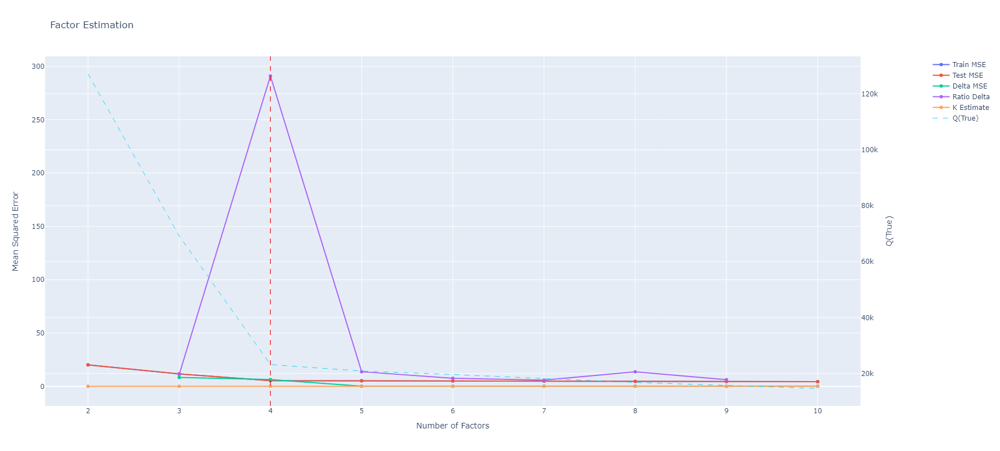

In [14]:
# Plot the results of the factor search; the red vertical dashed line is the factor count with the maximum Delta Ratio,
# the black vertical dashed line is true number of factors (only plotted when sythetic data have been generated).
factor_est.plot(actual_count=syn_factors)
estimated_factors = factor_est.estimated_factor

#### Model Training Input Parameters

In [15]:
index_col = "Date"                  # the index of the input/uncertainty datasets
# factors = syn_factors             # the number of factors set by the initial synthetic parameters above
factors = 5                         # the number of factors in the model
method = "ls-nmf"                   # "ls-nmf", "ws-nmf"
models = 20                         # the number of models to train
init_method = "col_means"           # default is column means "col_means", "kmeans", "cmeans"
init_norm = True                    # if init_method=kmeans or cmeans, normalize the data prior to clustering.
seed = 332                           # random seed for initialization
max_iterations = 20000              # the maximum number of iterations for fitting a model
converge_delta = 0.1                # convergence criteria for the change in loss, Q
converge_n = 25                     # convergence criteria for the number of steps where the loss changes by less than converge_delta
verbose = True                      # adds more verbosity to the algorithm workflow on execution.
optimized = True                    # use the Rust code if possible
parallel = True                     # execute the model training in parallel, multiple models at the same time

#### Train Model

In [16]:
%%time
# Training multiple models, optional parameters are commented out. Model with lowest QTrue shown at the end (using zero indexing for model number)
sa_models = BatchSA(V=V, U=U, factors=factors, models=models, method=method, seed=seed, max_iter=max_iterations,
                    init_method=init_method, init_norm=init_norm,
                    converge_delta=converge_delta, converge_n=converge_n, 
                    parallel=parallel, optimized=optimized,
                    verbose=True
                   )
_ = sa_models.train()

lowest_Q_model = sa_models.best_model
lowest_Q_model

23-Aug-24 09:19:09 - Model: 1, Q(true): 21142.4768, MSE(true): 0.6218, Q(robust): 21126.0079, MSE(robust): 0.6214, Seed: 42393, Converged: True, Steps: 8435/20000
23-Aug-24 09:19:09 - Model: 2, Q(true): 20311.0795, MSE(true): 0.5974, Q(robust): 20292.7853, MSE(robust): 0.5968, Seed: 13010, Converged: True, Steps: 16779/20000
23-Aug-24 09:19:09 - Model: 3, Q(true): 20292.4727, MSE(true): 0.5968, Q(robust): 20276.9262, MSE(robust): 0.5964, Seed: 45369, Converged: True, Steps: 11526/20000
23-Aug-24 09:19:09 - Model: 4, Q(true): 20758.0669, MSE(true): 0.6105, Q(robust): 20746.6047, MSE(robust): 0.6102, Seed: 76369, Converged: True, Steps: 10028/20000
23-Aug-24 09:19:09 - Model: 5, Q(true): 20555.9592, MSE(true): 0.6046, Q(robust): 20542.0207, MSE(robust): 0.6042, Seed: 12963, Converged: True, Steps: 4017/20000
23-Aug-24 09:19:09 - Model: 6, Q(true): 20326.0788, MSE(true): 0.5978, Q(robust): 20310.6375, MSE(robust): 0.5974, Seed: 29462, Converged: True, Steps: 13330/20000
23-Aug-24 09:19:09

CPU times: total: 797 ms
Wall time: 2min 5s


15

#### Batch Analysis

These methods allow plotting/reviewing results of models fit via the BatchSA training.

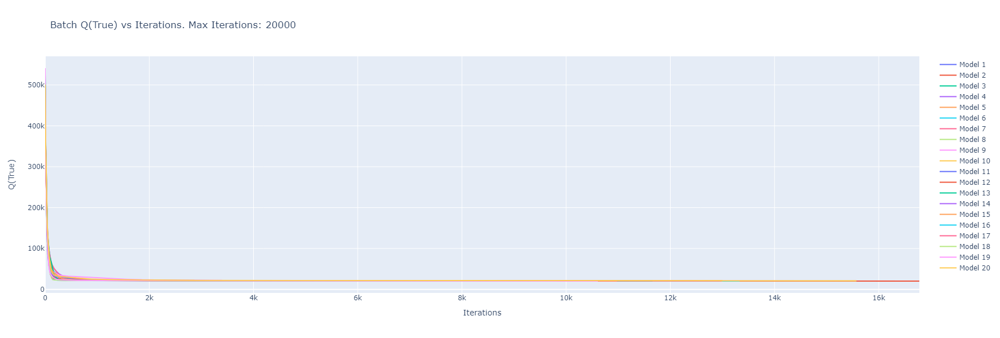

In [17]:
# Perform batch model analysis
batch_analysis = BatchAnalysis(batch_sa=sa_models, data_handler=data_handler)
# Plot the loss of the models over iterations
batch_analysis.plot_loss()

In [18]:
# Plot the loss distribution for the batch models
batch_analysis.plot_loss_distribution()

In [19]:
# Plot the concentration and residuals for each model for a specified feature with starting index of 0
batch_analysis.plot_temporal_residuals(feature_idx=0)

### Compare to Synthetic Data

Compare the set of batch models to the original synthetic factor data.


In [20]:
simulator.compare(batch_sa=sa_models)

23-Aug-24 09:19:14 - Searching all models in the batch to find which has the highest average correlation mapping.
Calculating correlation between base and model factors: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:00<00:00, 626.91it/s]
Calculating average correlation for all permutations for Model: 20: 100%|████████████████████████████████████████████████████████████████████████████████████| 2400/2400 [05:37<00:00,  7.10it/s]
23-Aug-24 09:24:52 - R2 - Model: 7, Best permutations: ['Factor 5', 'Factor 1', 'Factor 4', 'Factor 2'], Average R2: 0.9651367503662, 
Profile R2 Avg: 0.9656175883837526, Contribution R2 Avg: 0.9702747115321912, WH R2 Avg: 0.959517951182656
Profile R2: [0.8741489839247052, 0.9988139988845383, 0.99894992984705, 0.9905574408787163], 
Contribution R2: [0.9707494568429018, 0.9752844300322655, 0.9640361808388008, 0.9710287784147965], 
WH R2: [0.8788984967204274, 0.9905536807301906, 0.98743230819239

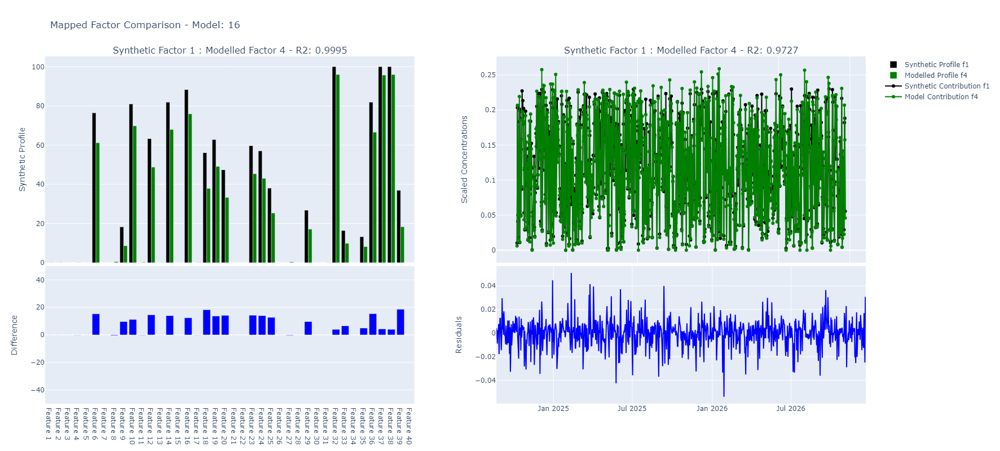

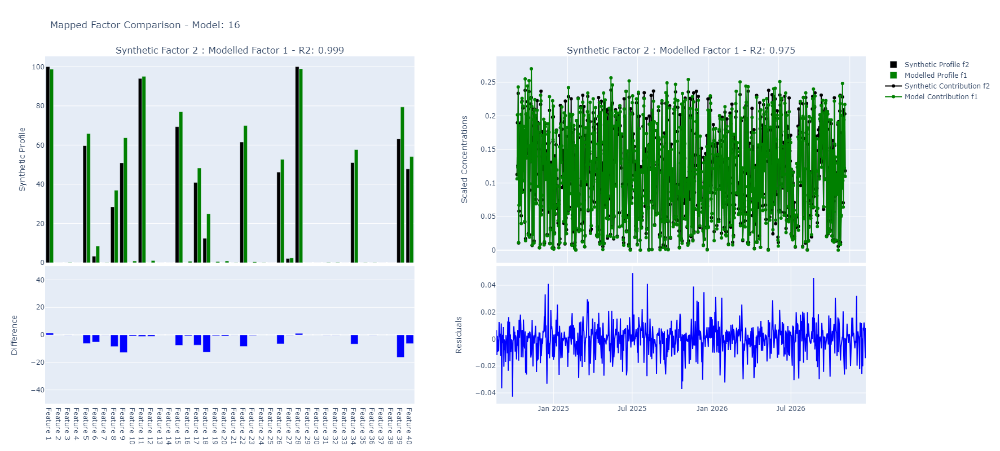

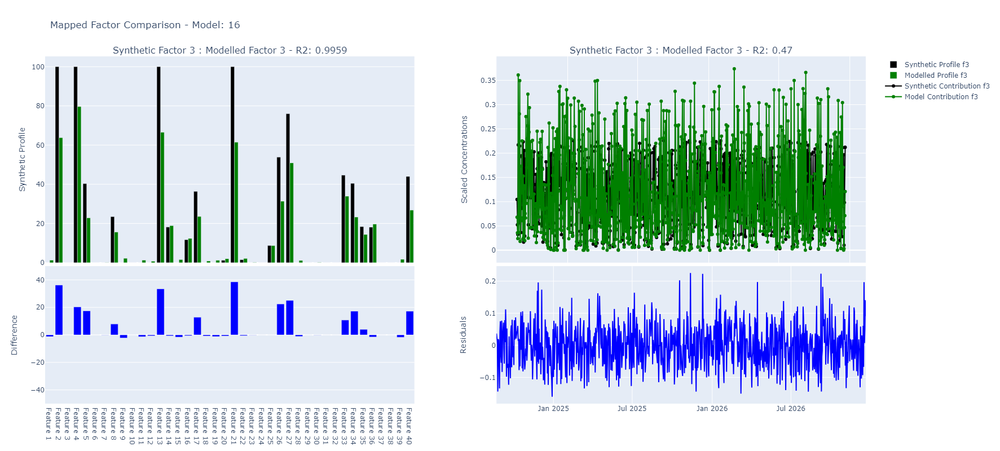

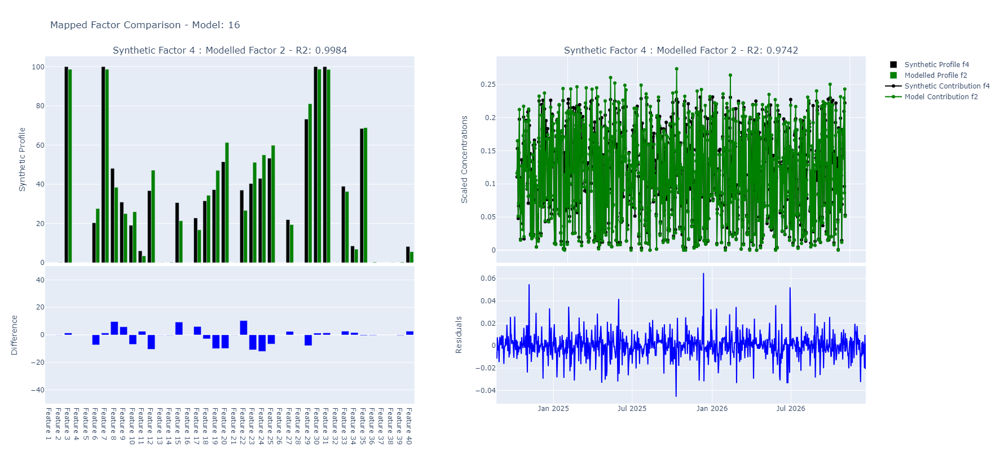

In [21]:
# Plot the factor/feature mapping of the best model by lowest QTrue
simulator.plot_comparison(model_i=lowest_Q_model)

In [22]:
# Save the Simulator instance, saves the instance as a pickle file and saves the synthetic profiles, contributions, data and uncertainty as csv files.
# sim_name = "synthetic"
# sim_output_dir = "D:/git/esat/notebooks/"
# simulator.save(sim_name=sim_name, output_directory=sim_output_dir)

In [23]:
# Load a previously saved Simulator instance
# simulator_file = "D:/git/esat/notebooks/esat_simulator.pkl"
# simulator_2 = Simulator.load(file_path=simulator_file)
# simulator_2.factor_compare.print_results()

In [24]:
# Selet the model with highest correlations to the sythetic profiles (using zero indexing for the model number)
highest_corr_model = simulator.factor_compare.best_model
highest_corr_model

6

In [25]:
# Plot mapping results for best model by highest average correlation with sythetic data
simulator.plot_comparison(model_i=highest_corr_model)

In [26]:
# Initialize the Model Analysis module for the model with lowest QTrue or the model with highest correlation to sythetic data

#sa_model = sa_models.results[lowest_Q_model]
#model_analysis = ModelAnalysis(datahandler=data_handler, model=sa_model, selected_model=lowest_Q_model)

sa_model = sa_models.results[highest_corr_model]
model_analysis = ModelAnalysis(datahandler=data_handler, model=sa_model, selected_model=highest_corr_model)

In [27]:
# Residual Analysis shows the scaled residual histogram for a specified feature (with zero indexing), along with metrics and distribution curves. The abs_threshold parameter specifies the condition for the returned values of the function call as those residuals which exceed the absolute value of that threshold.
abs_threshold = 3.0
threshold_residuals = model_analysis.plot_residual_histogram(feature_idx=5, abs_threshold=abs_threshold)

In [28]:
print(f"List of Absolute Scaled Residual Greather than: {abs_threshold}. Count: {threshold_residuals.shape[0]}")
threshold_residuals

List of Absolute Scaled Residual Greather than: 3.0. Count: 0


,Feature 6,datetime


In [29]:
# The model output statistics for the estimated V, including SE: Standard Error metrics, and 3 normal distribution tests of the residuals (KS Normal is used in PMF5)
model_analysis.calculate_statistics()
model_analysis.statistics

,Features,Category,r2,Intercept,Intercept SE,Slope,Slope SE,SE,SE Regression,Anderson Normal Residual,Anderson Statistic,Shapiro Normal Residuals,Shapiro PValue,KS Normal Residuals,KS PValue,KS Statistic
0,Feature 1,strong,0.894043,0.240288,0.040519,0.883036,0.010439,0.022642,0.616088,No,5.989550,No,9.222069e-09,No,7.938242e-04,0.067653
1,Feature 2,strong,0.910838,0.298174,0.048166,0.885360,0.009512,0.026437,0.712184,No,3.223971,No,3.270736e-06,No,4.556190e-03,0.059614
2,Feature 3,strong,0.845728,0.513524,0.055199,0.791633,0.011611,0.033920,0.841900,No,9.636989,No,4.343502e-11,No,2.311496e-06,0.089411
3,Feature 4,strong,0.917119,0.065761,0.007940,0.868145,0.008962,0.004595,0.119568,No,15.594891,No,2.932055e-14,No,3.578885e-10,0.114552
4,Feature 5,strong,0.818394,2.547779,0.233257,0.785558,0.012708,0.112464,2.836937,No,19.742226,No,6.950127e-17,No,3.190704e-12,0.126003
5,Feature 6,strong,0.767398,1.413193,0.101111,0.699537,0.013225,0.059427,1.366036,No,32.212422,No,2.249990e-21,No,1.015529e-19,0.161013
6,Feature 7,strong,0.939585,0.026286,0.004392,0.917938,0.007993,0.002371,0.065187,1.0,0.930636,No,8.040124e-05,Yes,4.891315e-01,0.028430
7,Feature 8,strong,0.745948,2.210461,0.151515,0.713791,0.014305,0.067412,1.619876,No,24.732487,No,2.111317e-19,No,9.519308e-15,0.138803
8,Feature 9,strong,0.758315,1.891300,0.130275,0.718431,0.013928,0.060482,1.448490,No,26.243195,No,2.682835e-20,No,1.662697e-17,0.151533
9,Feature 10,strong,0.839949,0.532096,0.056440,0.803668,0.012047,0.029726,0.756264,No,25.041800,No,3.637677e-19,No,4.252259e-18,0.154127


In [30]:
# Model feature observed vs predicted plot with regression and one-to-one lines. Feature/Column specified by index (using zero indexing).
model_analysis.plot_estimated_observed(feature_idx=4)

In [31]:
# Model feature timeseries analysis plot showing the observed vs predicted values of the feature, along with the residuals shown below. Feature/column specified by index (using zero indexing).
model_analysis.plot_estimated_timeseries(feature_idx=4)

In [32]:
# Top Plot: factor profile showing the sum of concentrations over all samples for each feature (blue bars) and the percentage of the feature for this factor (red dot);
# summing this percent for a specific feature over all model factors would = 100; bottom plot shows the normalized contributions by date (values are resampled at a daily timestep for timeseries consistency)
# Factor specified by index, starting at 1
model_analysis.plot_factor_profile(factor_idx=1)

In [33]:
# Model factor fingerprint specifies the feature percentage of each factor.
model_analysis.plot_factor_fingerprints(grouped=False)

In [34]:
# Factor G-Space plot shows the normalized contributions of one factor vs another factor. Factor specified by index (starting at 1).
model_analysis.plot_g_space(factor_1=3, factor_2=1)

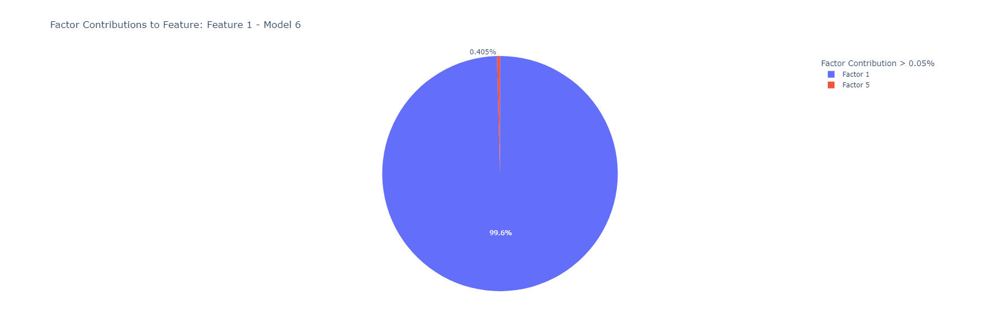

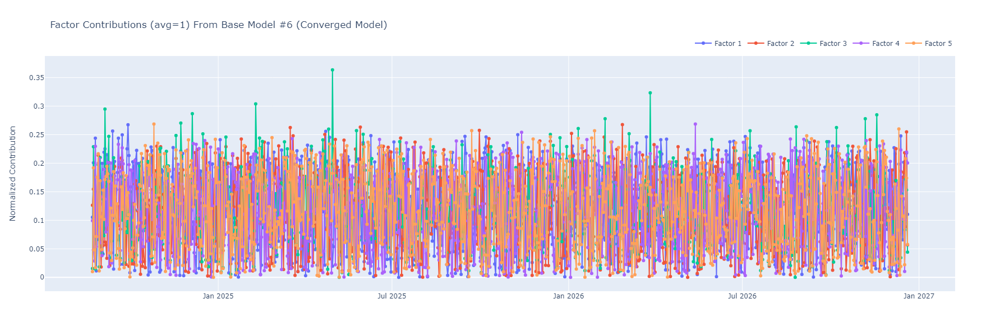

In [35]:
# Factor contribution pie chart shows the percentage of factor contributions for the specified feature, and the corresponding normalized contribution of each factor for that feature (bottom plot). Feature specified by index (starting at 0).
model_analysis.plot_factor_contributions(feature_idx=0)